In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
import math
from scipy import signal
from scipy.fft import fft, ifft
import soundfile as sf
from IPython.display import Audio

In [2]:
class RingBuffer(object):
    def __init__(self, maxDelay):
        self.maxDelay = maxDelay + 1
        self.buf = np.zeros(self.maxDelay)
        self.writeInd = 0

    def pushSample(self, s):
        self.buf[self.writeInd] = s
        self.writeInd = (self.writeInd + 1) % self.maxDelay

    def delayedSample(self, d):
        d = min(self.maxDelay - 1, max(0, d))
        i = ((self.writeInd + self.maxDelay) - d) % self.maxDelay
        return self.buf[i]


In [3]:
# Delay

x, sr = sf.read('input/sv.wav')

delayTime = 0.25
delaySamps = int(delayTime * sr)
outputSamps = len(x) + delaySamps

y = np.zeros(outputSamps)
ringBuf = RingBuffer(delaySamps)
for i in range(outputSamps):
    s = x[i] if i < len(x) else 0
    ringBuf.pushSample(s)
    y[i] = s * 0.5 + ringBuf.delayedSample(delaySamps) * 0.5

output = 'output/sv_simpleEcho.wav'
sf.write(output, y, sr)
Audio(output)  

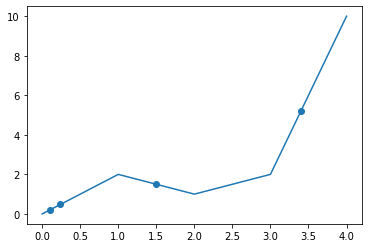

In [4]:
# Linear Interpolation
class LinearWrap(object):
    def __init__(self, it):
        self.it = it
        
    def __len__(self):
        return len(self.it)
        
    def __setitem__(self, inI, val):
        if type(inI) != int:
            raise RuntimeError('Can only write to integer values')
        self.it[inI] = val

    def __getitem__(self, inI):
        loI = math.floor(inI)
        hiI = math.ceil(inI)
        a = inI - loI
        inRange = lambda val: val >= 0 and val < len(self.it)
        loX = self.it[loI] if inRange(loI) else 0
        hiX = self.it[hiI] if inRange(hiI) else 0
        return loX * (1-a) + hiX * a


# Test it's working
buf =    [0, 2, 1, 2, 10]

plt.plot([0, 1, 2, 3, 4], buf)

linBuf = LinearWrap(buf)

plt.scatter([0.1, 0.24, 1.5, 3.4],
            [linBuf[0.1], linBuf[0.24], linBuf[1.5], linBuf[3.4]])

In [5]:
speed = 1.06

x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

outSamps = int(len(x) / speed)
y = np.zeros(outSamps)
for rawI in range(outSamps):
    i = rawI * speed
    y[rawI] = x[i]

output = 'output/sv_106.wav'
sf.write(output, y, sr)
Audio(output)

In [6]:
speed = 0.94

x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

outSamps = int(len(x) / speed)
y = np.zeros(outSamps)
for rawI in range(outSamps):
    i = rawI * speed
    y[rawI] = x[i]

output = 'output/sv_094.wav'
sf.write(output, y, sr)
Audio(output)  

In [7]:
# Wrap inner iterable inside RingBuffer with float indexable array
class LinearRingBuffer(RingBuffer):
    def __init__(self, maxDelay):
        self.maxDelay = maxDelay + 1
        self.buf = LinearWrap(np.zeros(self.maxDelay))
        self.writeInd = 0


In [8]:
# Modulated Echo (Vibrato)
x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

maxDelaySamps = 200
outputSamps = len(x) + maxDelaySamps
y = np.zeros(outputSamps)
ringBuf = LinearRingBuffer(maxDelaySamps)

fmod = 1
deltaPhi = fmod/sr
phi = 0

for i in range(outputSamps):
    s = x[i]
    ringBuf.pushSample(s)
    delaySamps = int((math.sin(2 * math.pi * phi) + 1.001) * maxDelaySamps)
    y[i] = ringBuf.delayedSample(delaySamps) * 0.5

    phi = phi + deltaPhi
    while phi >= 1:
        phi -= 1

output = 'output/sv_modulatedEcho.wav'
sf.write(output, y, sr)
Audio(output)  

In [9]:
# Slapback
x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

output = 'output/sv_slapback.wav'

fmod = 0
A = 0
M = int(0.02 * sr)
BL = 0.7
FF = 0.7

if A > M:
    raise RuntimeError("Amplitude of vibrato too high for delay length")

maxDelaySamps = M + A + 2 # Probably don't need the 2 here, but being safe
outputSamps = len(x) + maxDelaySamps
y = np.zeros(outputSamps)
ringBuf = LinearRingBuffer(maxDelaySamps)
deltaPhi = fmod/sr
phi = 0

for i in range(outputSamps):
    s = x[i]
    ringBuf.pushSample(s)
    delaySamps = int(math.sin(2 * math.pi * phi) * maxDelaySamps)
    y[i] = s * BL + ringBuf.delayedSample(delaySamps) * FF

    phi = phi + deltaPhi
    while phi >= 1:
        phi -= 1

sf.write(output, y, sr)
Audio(output)  


In [10]:
# Simple Echo
x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

output = 'output/sv_simpleEcho2.wav'

fmod = 0
A = 0
M = int(0.05 * sr)
BL = 0.7
FF = 0.7

if A > M:
    raise RuntimeError("Amplitude of vibrato too high for delay length")

maxDelaySamps = M + A + 2 # Probably don't need the 2 here, but being safe
outputSamps = len(x) + maxDelaySamps
y = np.zeros(outputSamps)
ringBuf = LinearRingBuffer(maxDelaySamps)
deltaPhi = fmod/sr
phi = 0

for i in range(outputSamps):
    s = x[i]
    ringBuf.pushSample(s)
    delaySamps = int(math.sin(2 * math.pi * phi) * maxDelaySamps)
    y[i] = s * BL + ringBuf.delayedSample(delaySamps) * FF

    phi = phi + deltaPhi
    while phi >= 1:
        phi -= 1

sf.write(output, y, sr)
Audio(output)  



In [11]:
# Simple Flanger
x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

output = 'output/sv_simpleFlanger.wav'

fmod = 0.2
A = int(0.002 * sr)
M = int(0.002 * sr)
BL = 0.7
FF = 0.7

if A > M:
    raise RuntimeError("Amplitude of vibrato too high for delay length")

maxDelaySamps = M + A + 2 # Probably don't need the 2 here, but being safe
outputSamps = len(x) + maxDelaySamps
y = np.zeros(outputSamps)
ringBuf = LinearRingBuffer(maxDelaySamps)
deltaPhi = fmod/sr
phi = 0

for i in range(outputSamps):
    s = x[i]
    ringBuf.pushSample(s)
    delaySamps = int(math.sin(2 * math.pi * phi) * maxDelaySamps)
    y[i] = s * BL + ringBuf.delayedSample(delaySamps) * FF

    phi = phi + deltaPhi
    while phi >= 1:
        phi -= 1

sf.write(output, y, sr)
Audio(output)


In [12]:
# Simple Chorus
x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

output = 'output/sv_simpleChorus.wav'

fmod = 1.5
A = int(0.002 * sr)
M = int(0.002 * sr)
BL = 1.0
FF = 0.7

if A > M:
    raise RuntimeError("Amplitude of vibrato too high for delay length")

maxDelaySamps = M + A + 2 # Probably don't need the 2 here, but being safe
outputSamps = len(x) + maxDelaySamps
y = np.zeros(outputSamps)
ringBuf = LinearRingBuffer(maxDelaySamps)
deltaPhi = fmod/sr
phi = 0

for i in range(outputSamps):
    s = x[i]
    ringBuf.pushSample(s)
    delaySamps = int(math.sin(2 * math.pi * phi) * maxDelaySamps)
    y[i] = s * BL + ringBuf.delayedSample(delaySamps) * FF

    phi = phi + deltaPhi
    while phi >= 1:
        phi -= 1

sf.write(output, y, sr)
Audio(output)


In [13]:
# Simple Flanger with feedback
x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

output = 'output/sv_simpleFlangerWithFeedback.wav'

fmod = 0.1
A = int(0.005 * sr)
M = int(0.005 * sr)
BL = 0.7
FF = 0.7
FB = -0.7

if A > M:
    raise RuntimeError("Amplitude of vibrato too high for delay length")

maxDelaySamps = M + A + 2 # Probably don't need the 2 here, but being safe
outputSamps = len(x) + maxDelaySamps
y = np.zeros(outputSamps)
ringBuf = LinearRingBuffer(maxDelaySamps)
prevDelaySamp = 0
deltaPhi = fmod/sr
phi = 0

for i in range(outputSamps):
    s = x[i] + prevDelaySamp * FB
    ringBuf.pushSample(s)
    delaySamps = int(math.sin(2 * math.pi * phi) * maxDelaySamps)
    prevDelaySamp = ringBuf.delayedSample(delaySamps)
    y[i] = s * BL + prevDelaySamp * FF

    phi = phi + deltaPhi
    while phi >= 1:
        phi -= 1

sf.write(output, y, sr)
Audio(output)

In [14]:
# White Chorus
x, sr = sf.read('input/sv.wav')
x = LinearWrap(x)

output = 'output/sv_whiteChorus.wav'

fmod = 1.5
A = int(0.002 * sr)
M = int(0.002 * sr)
BL = 1.0
FF = 0.7
FB = -0.7

if A > M:
    raise RuntimeError("Amplitude of vibrato too high for delay length")

maxDelaySamps = M + A + 2 # Probably don't need the 2 here, but being safe
outputSamps = len(x) + maxDelaySamps
y = np.zeros(outputSamps)
ringBuf = LinearRingBuffer(maxDelaySamps)
prevDelaySamp = 0
deltaPhi = fmod/sr
phi = 0

for i in range(outputSamps):
    s = x[i] + prevDelaySamp * FB
    ringBuf.pushSample(s)
    delaySamps = int(math.sin(2 * math.pi * phi) * maxDelaySamps)
    prevDelaySamp = ringBuf.delayedSample(delaySamps)
    y[i] = s * BL + prevDelaySamp * FF

    phi = phi + deltaPhi
    while phi >= 1:
        phi -= 1

sf.write(output, y, sr)
Audio(output)